### **Task : *Use a range of classifiers to determine which one delivers the best performance***

**Step 1: Load the Data**

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, f1_score, precision_score, recall_score, accuracy_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score


In [ ]:
# Load data
data = pd.read_excel('/content/DataSet_EU_3k_5k.xlsx')

In [ ]:
#Describing Data
data.info()
data.head()
# Display basic information about the dataset
print(f"Number of columns: {len(data.columns)}")
print(f"Columns: {data.columns.tolist()}")
print(f"Shape of the data: {data.shape}")
print(f"Data types:\n{data.dtypes}")
# Describe the numerical features
print(data.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18000 entries, 0 to 17999
Columns: 382 entries, Power_1 to Total Distance(m)
dtypes: float64(305), int64(77)
memory usage: 52.5 MB
Number of columns: 382
Columns: ['Power_1', 'Power_2', 'Power_3', 'Power_4', 'Power_5', 'Power_6', 'Power_7', 'Power_8', 'Power_9', 'Power_10', 'Power_11', 'Power_12', 'Power_13', 'Power_14', 'Power_15', 'Power_16', 'Power_17', 'Power_18', 'Power_19', 'Power_20', 'Power_21', 'Power_22', 'Power_23', 'Power_24', 'Power_25', 'Power_26', 'Power_27', 'Power_28', 'Power_29', 'Power_30', 'Power_31', 'Power_32', 'Power_33', 'Power_34', 'Power_35', 'Power_36', 'Power_37', 'Power_38', 'Power_39', 'Power_40', 'Power_41', 'Power_42', 'Power_43', 'Power_44', 'Power_45', 'Power_46', 'Power_47', 'Power_48', 'Power_49', 'Power_50', 'Power_51', 'Power_52', 'Power_53', 'Power_54', 'Power_55', 'Power_56', 'Power_57', 'Power_58', 'Power_59', 'Power_60', 'Power_61', 'Power_62', 'Power_63', 'Power_64', 'Power_65', 'Power_66', 'Po

**Step 2: Visualisation**

In [ ]:
# Calculate correlations with GSNR_1
correlations = data.corrwith(data['GSNR_1']).sort_values(ascending=False)

# Set the number of columns for subplots
num_cols = 4
num_rows = (len(correlations.index) - 1) // num_cols + 1

# Create subplots
plt.figure(figsize=(18, 4 * num_rows))
for i, feature in enumerate(correlations.index, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.scatterplot(x=data[feature], y=data['GSNR_1'])
    plt.title(f'Correlation: {feature} vs GSNR_1')
    plt.xlabel(feature)
    plt.ylabel('GSNR_1')
    plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# Initialize an empty list to store column names
features_to_plot = []

# Populate features_to_plot with all column names from data
for feature in data.columns:
    features_to_plot.append(feature)

# Plotting histograms for selected features
num_features = len(features_to_plot)
num_cols = 5
num_rows = (num_features - 1) // num_cols + 1  # Calculate number of rows needed

plt.figure(figsize=(18, 4 * num_rows))  # Adjust figure size based on number of rows

for i, feature in enumerate(features_to_plot, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.histplot(data[feature], kde=True)
    plt.title(f'{feature} Distribution')
    plt.xlabel(feature)
    plt.ylabel('Count')

plt.tight_layout()
plt.show()

**Step 3: Data-Preprocessing**

In [ ]:
# Drop GSNR_2 to GSNR_76 and frequency_1 to frequency_76
gsnr_columns = [f'GSNR_{i}' for i in range(2, 77)]
frequency_columns = [f'frequency_{i}' for i in range(1, 77)]
data = data.drop(columns=gsnr_columns + frequency_columns)

# Set target variable (GSNR_1)
target = 'GSNR_1'
X = data.drop(columns=[target])
y = data[target]

In [ ]:
# Check for missing values
missing_values = X.isnull().sum()
# Fill missing values with mean (replace with appropriate strategy)
X.fillna(X.mean(), inplace=True)

In [ ]:
# Remove duplicate rows
X.drop_duplicates(inplace=True)

In [ ]:
#Normalisation
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)

In [ ]:
# Convert back to DataFrame (optional)
X_normalized = pd.DataFrame(X_normalized, columns=X.columns)

In [ ]:
# Normalize target
scaler_y = MinMaxScaler()
y_normalized = scaler_y.fit_transform(y.values.reshape(-1, 1)).flatten()

In [ ]:
# Print first few rows of normalized data
print(X_normalized.head())

    Power_1   Power_2   Power_3   Power_4   Power_5   Power_6   Power_7  \
0  0.000000  0.000000  0.078083  0.078033  0.078096  0.000000  0.078137   
1  0.000000  0.076196  0.000000  0.076157  0.000000  0.076232  0.000000   
2  0.000000  0.000000  0.000000  0.076802  0.000000  0.000000  0.000000   
3  0.076798  0.076735  0.076733  0.076759  0.076768  0.000000  0.000000   
4  0.000000  0.000000  0.074533  0.000000  0.074548  0.000000  0.000000   

   Power_8   Power_9  Power_10  ...    ASE_69    ASE_70    ASE_71    ASE_72  \
0      0.0  0.078193       0.0  ...  0.000100  0.075097  0.075104  0.075102   
1      0.0  0.000000       0.0  ...  0.073196  0.000051  0.073190  0.073188   
2      0.0  0.076955       0.0  ...  0.073781  0.073768  0.000105  0.073773   
3      0.0  0.076982       0.0  ...  0.000123  0.000099  0.000104  0.000125   
4      0.0  0.074606       0.0  ...  0.071540  0.071527  0.000093  0.000077   

     ASE_73    ASE_74    ASE_75    ASE_76  No. Spans  Total Distance(m)  


**Step 4: Post-Processing Description**

In [ ]:
#Describing Data
X_normalized.info()
X_normalized.head()
# Display basic information about the dataset
print(f"Number of columns: {len(X_normalized.columns)}")
print(f"Columns: {X_normalized.columns.tolist()}")
print(f"Shape of the data: {X_normalized.shape}")
print(f"Data types:\n{X_normalized.dtypes}")
# Describe the numerical features
print(X_normalized.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18000 entries, 0 to 17999
Columns: 230 entries, Power_1 to Total Distance(m)
dtypes: float64(230)
memory usage: 31.6 MB
Number of columns: 230
Columns: ['Power_1', 'Power_2', 'Power_3', 'Power_4', 'Power_5', 'Power_6', 'Power_7', 'Power_8', 'Power_9', 'Power_10', 'Power_11', 'Power_12', 'Power_13', 'Power_14', 'Power_15', 'Power_16', 'Power_17', 'Power_18', 'Power_19', 'Power_20', 'Power_21', 'Power_22', 'Power_23', 'Power_24', 'Power_25', 'Power_26', 'Power_27', 'Power_28', 'Power_29', 'Power_30', 'Power_31', 'Power_32', 'Power_33', 'Power_34', 'Power_35', 'Power_36', 'Power_37', 'Power_38', 'Power_39', 'Power_40', 'Power_41', 'Power_42', 'Power_43', 'Power_44', 'Power_45', 'Power_46', 'Power_47', 'Power_48', 'Power_49', 'Power_50', 'Power_51', 'Power_52', 'Power_53', 'Power_54', 'Power_55', 'Power_56', 'Power_57', 'Power_58', 'Power_59', 'Power_60', 'Power_61', 'Power_62', 'Power_63', 'Power_64', 'Power_65', 'Power_66', 'Power_67', 'P

**Step 5: Visualisation**

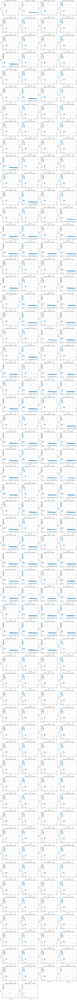

In [ ]:
# Convert y_normalized back to a Pandas Series
y_normalized_series = pd.Series(y_normalized)

# Calculate correlations with GSNR_1
correlations = X_normalized.corrwith(y_normalized_series).sort_values(ascending=False)

# Set the number of columns for subplots
num_cols = 4
num_rows = (len(correlations.index) - 1) // num_cols + 1

# Create subplots
plt.figure(figsize=(18, 4 * num_rows))
for i, feature in enumerate(correlations.index, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.scatterplot(x=X_normalized[feature], y=y_normalized_series)
    plt.title(f'Correlation: {feature} vs GSNR_1')
    plt.xlabel(feature)
    plt.ylabel('GSNR_1')
    plt.grid(True)

plt.tight_layout()
plt.show()

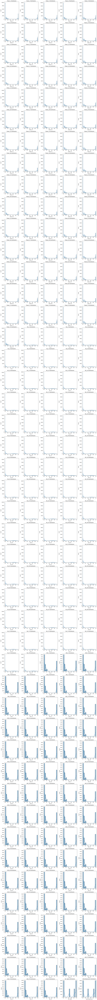

In [ ]:
# Initialize an empty list to store column names
features_to_plot = []

# Populate features_to_plot with all column names from data
for feature in X_normalized.columns:
    features_to_plot.append(feature)

# Plotting histograms for selected features
num_features = len(features_to_plot)
num_cols = 5
num_rows = (num_features - 1) // num_cols + 1  # Calculate number of rows needed

plt.figure(figsize=(18, 4 * num_rows))  # Adjust figure size based on number of rows

for i, feature in enumerate(features_to_plot, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.histplot(X_normalized[feature], kde=True)
    plt.title(f'{feature} Distribution')
    plt.xlabel(feature)
    plt.ylabel('Count')

plt.tight_layout()
plt.show()

**Step 6: Splitting the dataset**

In [ ]:
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized_series, test_size=0.2, random_state=42)

**Step 7: Selection Regression models**

In [ ]:

# Initialize models
models = {
    'Linear Regression': LinearRegression(),
    'Random Forest Regressor': RandomForestRegressor(),
    'Support Vector Regressor': SVR(),
    'Gradient Boosting Regressor': GradientBoostingRegressor(),
    'K-Nearest Neighbors Regressor': KNeighborsRegressor(),
    'XGBoost Regressor': xgb.XGBRegressor(),
    'Decision Tree Regressor': DecisionTreeRegressor(),
    'Lasso Regression': Lasso(max_iter=10000),
    'Ridge Regression': Ridge(),
    'ElasticNet Regression': ElasticNet()
}

**Step 8: Training the models**

**Step 9: Evaluating the models**

In [ ]:
# Initialize dictionaries to store evaluation metrics
metrics = {
    'Model': [],
    'Mean Squared Error': [],
    'R-squared': []
}

# Train and evaluate models
for name, model in models.items():
    # Train model
    model.fit(X_train, y_train)

    # Predict on test set
    y_pred = model.predict(X_test)

    # Calculate evaluation metrics
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Append metrics to dictionary
    metrics['Model'].append(name)
    metrics['Mean Squared Error'].append(mse)
    metrics['R-squared'].append(r2)

    # Print evaluation results
    print(f'{name} Mean Squared Error: {mse}')
    print(f'{name} R-squared: {r2}')
    print('-' * 50)


Linear Regression Mean Squared Error: 0.04424864213494735
Linear Regression R-squared: 0.40184566348783946
--------------------------------------------------
Random Forest Regressor Mean Squared Error: 2.264628539042273e-05
Random Forest Regressor R-squared: 0.9996938669039637
--------------------------------------------------
Support Vector Regressor Mean Squared Error: 0.025476352549405654
Support Vector Regressor R-squared: 0.6556099798618654
--------------------------------------------------
Gradient Boosting Regressor Mean Squared Error: 1.993174882904156e-05
Gradient Boosting Regressor R-squared: 0.9997305620823346
--------------------------------------------------
K-Nearest Neighbors Regressor Mean Squared Error: 0.027143366296007783
K-Nearest Neighbors Regressor R-squared: 0.6330752431231776
--------------------------------------------------
XGBoost Regressor Mean Squared Error: 1.4850454940019039e-05
XGBoost Regressor R-squared: 0.9997992511500249
-----------------------------

**Step 10: Visualisation**

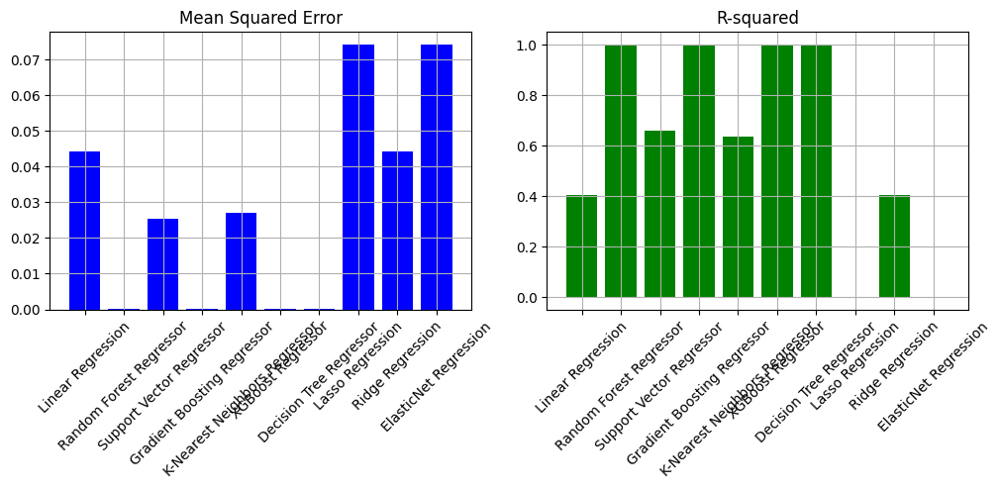

In [ ]:
# Convert metrics to DataFrame for plotting
metrics_df = pd.DataFrame(metrics)

# Plotting metrics
plt.figure(figsize=(15, 8))

# Plot Mean Squared Error
plt.subplot(2, 3, 1)
plt.bar(metrics_df['Model'], metrics_df['Mean Squared Error'], color='blue')
plt.title('Mean Squared Error')
plt.xticks(rotation=45)
plt.grid(True)

# Plot r2 Score
plt.subplot(2, 3, 2)
plt.bar(metrics_df['Model'], metrics_df['R-squared'], color='green')
plt.title('R-squared')
plt.xticks(rotation=45)
plt.grid(True)

plt.tight_layout()
plt.show()

**Conclusion**

XGBoost Regressor with the lowest MSE of 1.4850454940019039e-05.

Random Forest Regressor and XGBoost Regressor with R-squared of approximately 0.9997.

***`XGBoost Regressor`*** is recommended as the best model for predicting the target variable in this scenario due to its least MSE and highest r2 score compared to every other Regressor.